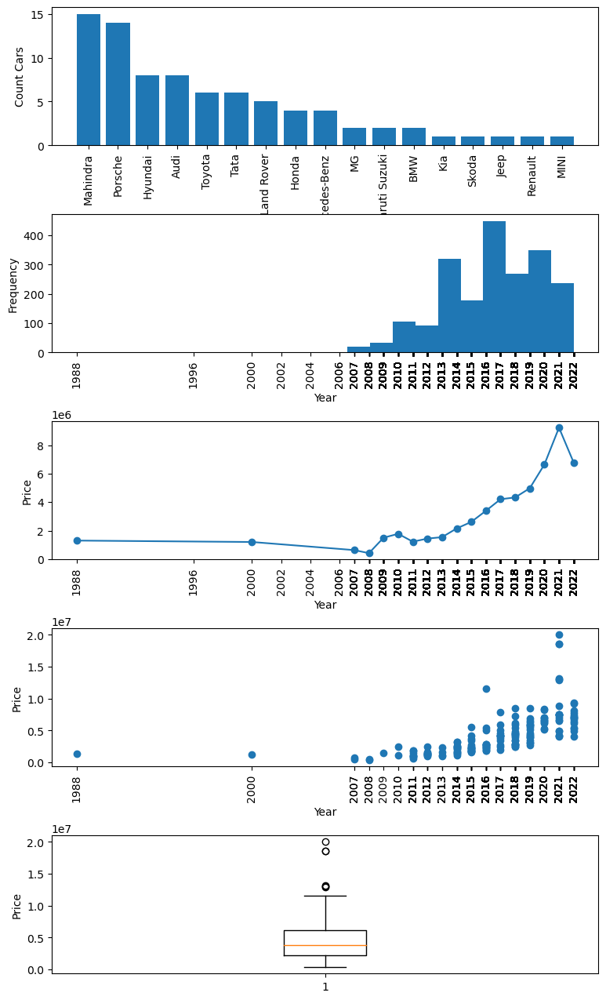

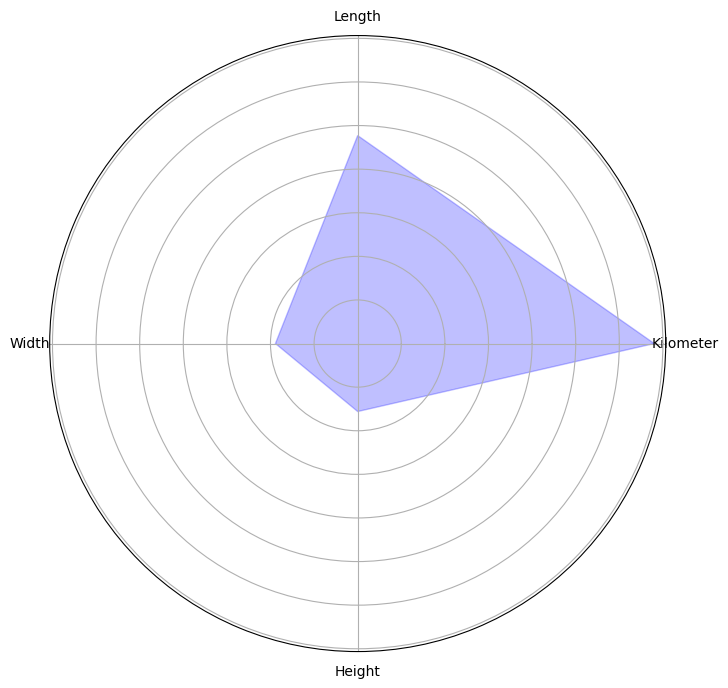

(1143, 2) (1143, 2)


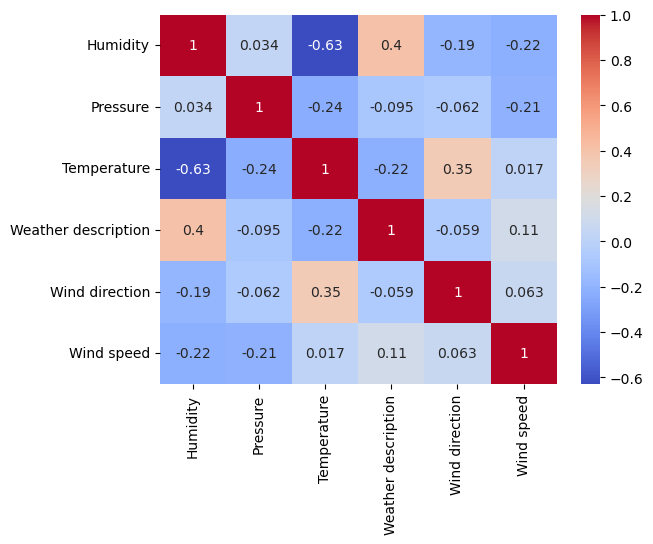

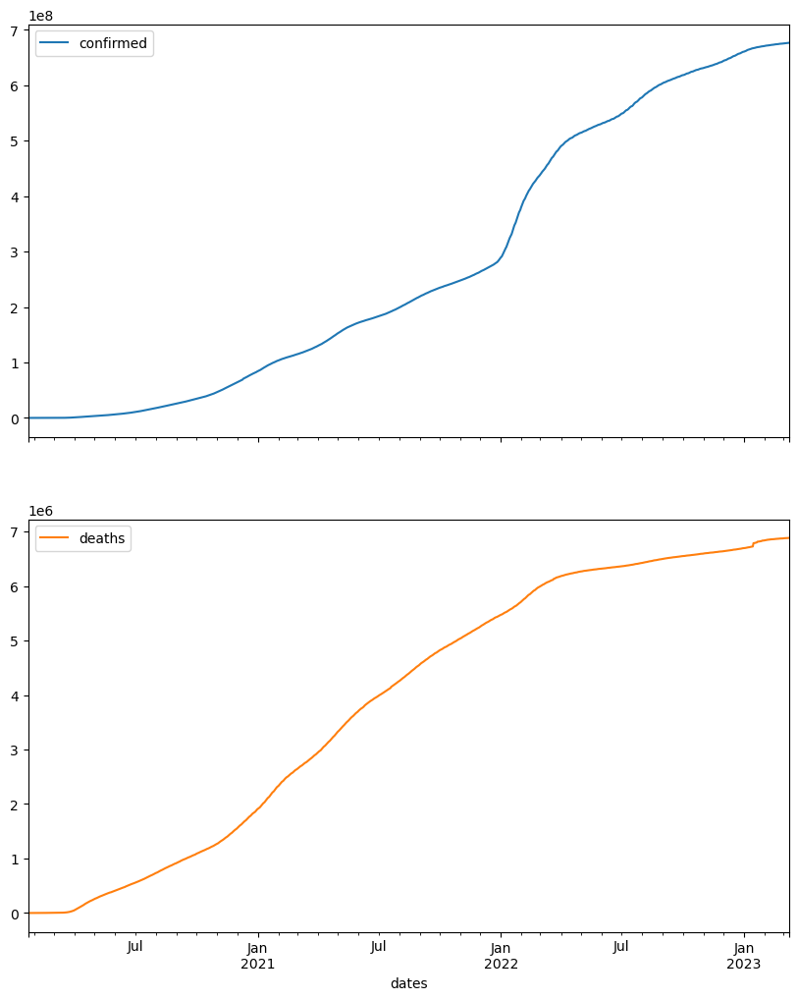

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import folium as fl
cars_df = pd.read_csv("D:/IDA/cars/car details v4.csv")
cars_companies=pd.DataFrame(data=cars_df.loc[cars_df["Year"] == 2022, ["Make", "Year"]])
humidity = pd.read_csv("D:/IDA/params/humidity.csv")
pressure = pd.read_csv("D:/IDA/params/pressure.csv")
temperature = pd.read_csv("D:/IDA/params/temperature.csv")
weather_description = pd.read_csv("D:/IDA/params/weather_description.csv")
wind_direction = pd.read_csv("D:/IDA/params/wind_direction.csv")
wind_speed = pd.read_csv("D:/IDA/params/wind_speed.csv")
#cars_companies=cars_companies.rename(columns={0:"Counts"})
fig, axes = plt.subplots(5, 1, figsize=(9, 16))
fig.subplots_adjust(hspace=0.5)
axes[0].bar(cars_companies["Make"].unique(), cars_companies.value_counts())
axes[0].tick_params(axis="x", rotation=90)
axes[0].set_ylabel("Count Cars")
axes[0].set_xlabel("Company")
axes[1].hist(cars_df["Year"], bins=cars_df["Year"].nunique())
axes[1].tick_params(axis="x", rotation=90)
axes[1].set_xticks(cars_df["Year"])
axes[1].set_ylabel("Frequency")   
axes[1].set_xlabel("Year")

cars_companies=pd.DataFrame(data=cars_df.loc[(cars_df["Make"] == "Mercedes-Benz"), ["Make", "Year","Price"]])
cars_companies_avg=pd.DataFrame(cars_companies.groupby(cars_companies["Year"])["Price"].mean())

axes[2].plot(cars_companies_avg.index, cars_companies_avg["Price"], marker="o")
axes[2].set_ylabel("Price")
axes[2].set_xlabel("Year")
axes[2].set_xticks(cars_df["Year"])
axes[2].tick_params(axis="x", rotation=90)
axes[3].scatter(x=cars_companies["Year"], y=cars_companies["Price"])
axes[3].set_ylabel("Price")
axes[3].set_xlabel("Year")
axes[3].set_xticks(cars_companies["Year"])
axes[3].tick_params(axis="x", rotation=90)
axes[4].boxplot(x=cars_companies["Price"])
axes[4].set_ylabel("Price")
cars_companies=pd.DataFrame(data=cars_df.loc[(cars_df["Make"] == "Mercedes-Benz") & (cars_df["Year"]==2022), ["Make", "Year", "Price","Kilometer", "Length","Width","Height", "Seating Capacity","Fuel Tank Capacity"]])
categories=["Kilometer", "Length","Width","Height"]
values=[]
for category in categories:
    values.append(cars_companies[category].mean())
#values = np.array(values)
values+=values[:1]
plt.figure(figsize=(8,8))
ax=plt.subplot(polar=True)
angles= [n/float(len(categories)) * 2 * np.pi for n in range(len(categories))]
angles+=angles[:1]
ax.fill(angles, values, color="blue", alpha=0.25)
ax.set_yticklabels([])
plt.xticks(angles[:-1], categories)
plt.show()
#2
portland_weather_df=pd.DataFrame({"Humidity" : humidity["Portland"],
                                  "Pressure" : pressure["Portland"],
                                  "Temperature" : temperature["Portland"],
                                  "Weather description" : weather_description["Portland"],
                                  "Wind direction" : wind_direction["Portland"],
                                  "Wind speed" : wind_speed["Portland"]
                                 })
portland_weather_df=portland_weather_df.dropna()
portland_weather_df
portland_weather_df["Weather description"], uniques = pd.factorize(portland_weather_df["Weather description"])
#portland_weather_df["Wind direction"], uniques = pd.factorize(portland_weather_df["Wind direction"])
portland_weather_df=portland_weather_df.astype({"Weather description" : "float64"})
correlation = portland_weather_df.corr()
sns.heatmap(correlation, annot=True, cmap="coolwarm")
portland_weather_df
#3
cities_df= pd.read_csv("D:/IDA/cities15000.csv", encoding='unicode_escape')
cities_df = cities_df.loc[:, ['latitude', 'longitude',"population"]]
#covid_19_df=covid_19_df.dropna(subset=["confirmed_cases", "province", "latitude", "longitude"])



cities_df=cities_df.drop(7675, axis=0)
#cities_df.loc[cities_df["latitude"]=="PPLA2"]
cities_df=cities_df.dropna()
cities_df=cities_df.astype({"latitude" : "float64", "longitude" : "float64", "population" : "int64"})
def colour_marker(value):
    if value > cities_df["population"].mean():
        return "red"
    else:
        return "green"
map = fl.Map(tiles='OpenStreetMap')
cities = fl.FeatureGroup(name="cities")
lat = list(cities_df["latitude"])
lon = list(cities_df["longitude"])
populations = list(cities_df["population"])
for lt, ln, population in zip(lat, lon, populations):
    cities.add_child(fl.CircleMarker(location=[lt, ln], radius=6, popup=str(population),
    fill_color=colour_marker(population), color = 'grey', fill=True, fill_opacity=0.7))
map.add_child(cities)
map.add_child(fl.LayerControl())

#4
# Загрузка данных по числу случаев заражения
confirmed_url = 'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv'
confirmed_df = pd.read_csv(confirmed_url)

# Загрузка данных по числу смертей
deaths_url = 'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_deaths_global.csv'
deaths_df = pd.read_csv(deaths_url)

# Подготовка данных для визуализации
confirmed_ts = confirmed_df.iloc[:, 4:].sum().reset_index(name='confirmed')
deaths_ts = deaths_df.iloc[:, 4:].sum().reset_index(name='deaths')

# Преобразование столбца с датами в формат datetime
confirmed_ts['index'] = pd.to_datetime(confirmed_ts['index'])
confirmed_ts=confirmed_ts.rename(columns={"index":'dates'})
deaths_ts['index'] = pd.to_datetime(deaths_ts['index'])

confirmed_ts["deaths"] = deaths_ts["deaths"]
confirmed_ts.index = confirmed_ts['dates']

confirmed_ts=confirmed_ts.drop('dates', axis=1)
confirmed_ts.plot(subplots=True, figsize=(10, 12))

print(confirmed_ts.shape, deaths_ts.shape)
confirmed_ts
map